In [173]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
import pca
import seaborn as sns
import pickle
import warnings
warnings.simplefilter("ignore")
pd.options.mode.chained_assignment = None  # default='warn'
%matplotlib inline
# from google.colab import drive
# drive.mount('/content/drive')

In [174]:
#readin data
data = pd.read_csv('/home/yamen/Projects/Technocolabs/Final_Dataset.csv')

In [175]:
def basic_info(df):
    df = pd.DataFrame(df)
    print("This dataset has ", df.shape[1], " columns and ", df.shape[0], " rows.")
    print("This dataset has ", df[df.duplicated()].shape[0], " duplicated rows.")
    print(" ")
    print("Descriptive statistics of the numeric features in the dataset: ")
    print(" ")
    print(df.describe())
    print(" ")
    print("Information about this dataset: ")
    print(" ")
    print(df.info())

def eda(data):
    print("----------Top-5- Record----------")
    print(data.head(5))
    print("-----------Data Types-----------")
    print(data.dtypes)
    print("----------Missing value-----------")
    print(data.isnull().sum())
    print("----------Null value-----------")
    print(data.isna().sum())
    print("----------Shape of Data----------")
    print(data.shape)

In [176]:
#Basic info of the dataset
basic_info(data)

eda(data)

This dataset has  524  columns and  742  rows.
This dataset has  0  duplicated rows.
 
Descriptive statistics of the numeric features in the dataset: 
 
            Label  chroma_stft_kew_0  chroma_stft_min_0  chroma_stft_max_0  \
count  742.000000         742.000000         742.000000         742.000000   
mean     0.497305           0.787428           0.017794           0.999901   
std      0.500330           0.572133           0.017147           0.002175   
min      0.000000          -0.768129           0.000098           0.943197   
25%      0.000000           0.409489           0.006254           1.000000   
50%      0.000000           0.765693           0.013134           1.000000   
75%      1.000000           1.152814           0.024148           1.000000   
max      1.000000           3.269741           0.157747           1.000000   

       chroma_stft_std_0  chroma_stft_mean_0  chroma_stft_median_0  \
count         742.000000          742.000000            742.000000   
mean

In [177]:
print(data.head())

print(data.columns)

           Artist                           Title  Label  \
0      The Weeknd                 Blinding Lights      1   
1  Olivia Rodrigo                        Good 4 U      1   
2  Olivia Rodrigo                 Drivers License      1   
3       Lil Nas X  Montero (Call Me By Your Name)      1   
4             BTS                          Butter      1   

                                                Path  \
0  The Weeknd - Blinding Lights (Official Video).mp3   
1     Olivia Rodrigo - good 4 u (Official Video).mp3   
2  Olivia Rodrigo - drivers license (Official Vid...   
3  Lil Nas X - MONTERO (Call Me By Your Name) (Of...   
4               BTS (방탄소년단) 'Butter' Official MV.mp3   

                                          choruspath  \
0  ./Data/RepeatedPopularChorus/The Weeknd - Blin...   
1  ./Data/RepeatedPopularChorus/Olivia Rodrigo - ...   
2  ./Data/RepeatedPopularChorus/Olivia Rodrigo - ...   
3  ./Data/RepeatedPopularChorus/Lil Nas X - MONTE...   
4  ./Data/RepeatedPopu

In [178]:
# Drop unnecessary columns which are dataset['Path'] and dataset['chourspath']
data = data.drop('Path', axis=1).drop('choruspath', axis=1)
print(data.head())


# Get list of categorical variables
s1 = (data.dtypes == 'object')
object_cols = list(s1[s1].index)

print("Categorical variables:")
print(object_cols)

           Artist                           Title  Label  \
0      The Weeknd                 Blinding Lights      1   
1  Olivia Rodrigo                        Good 4 U      1   
2  Olivia Rodrigo                 Drivers License      1   
3       Lil Nas X  Montero (Call Me By Your Name)      1   
4             BTS                          Butter      1   

                            title  chroma_stft_kew_0  chroma_stft_min_0  \
0                 Blinding Lights           0.412945           0.013187   
1                        Good 4 U           0.935186           0.007026   
2                 Drivers License           1.396619           0.000648   
3  Montero (Call Me By Your Name)           0.925184           0.003468   
4                          Butter           0.293021           0.037412   

   chroma_stft_max_0  chroma_stft_std_0  chroma_stft_mean_0  \
0                1.0           0.325001            0.478447   
1                1.0           0.288497            0.366746   

In [179]:
# considering all the numerical columns
df1=data.iloc[:,5:]
df1.head()

,chroma_stft_min_0,chroma_stft_max_0,chroma_stft_std_0,chroma_stft_mean_0,chroma_stft_median_0,chroma_stft_kurtosis_0,chroma_stft_kew_1,chroma_stft_min_1,chroma_stft_max_1,chroma_stft_std_1,...,tonnetz_mean_5,tonnetz_median_5,tonnetz_kurtosis_5,zero_crossing_rate_kew_0,zero_crossing_rate_min_0,zero_crossing_rate_max_0,zero_crossing_rate_std_0,zero_crossing_rate_mean_0,zero_crossing_rate_median_0,zero_crossing_rate_kurtosis_0
0,0.013187,1.0,0.325001,0.478447,0.389485,-1.234592,0.985769,0.012745,1.0,0.228237,...,0.006602,-0.002341,-0.518686,-0.211221,0.040726,0.124989,0.014687,0.088264,0.087959,0.271144
1,0.007026,1.0,0.288497,0.366746,0.277150,-0.191416,0.389105,0.004444,1.0,0.366763,...,-0.013171,-0.010406,0.023795,-0.355233,0.057143,0.222902,0.034833,0.147018,0.156825,-0.421549
2,0.000648,1.0,0.307654,0.236773,0.087021,0.746963,1.628271,0.000456,1.0,0.220626,...,0.000282,-0.009449,0.474475,0.764088,0.023401,0.176780,0.031920,0.076565,0.065442,-0.121262
3,0.003468,1.0,0.242792,0.301631,0.262468,0.273077,0.839956,0.003586,1.0,0.348793,...,-0.014510,-0.022827,0.472522,0.508823,0.049660,0.266803,0.043766,0.143524,0.137029,-0.377724
4,0.037412,1.0,0.335119,0.522938,0.454540,-1.439998,0.857308,0.048865,1.0,0.240635,...,0.007012,0.004794,-0.375049,2.562416,0.040181,0.220726,0.026899,0.096104,0.091293,7.762984


In [180]:
# removing the outliers with the help of iqr method
feature = df1 # one or more.
for cols in feature:
    Q1 = df1[cols].quantile(0.25)
    Q3 = df1[cols].quantile(0.75)
    IQR = Q3 - Q1
    dff = df1[((df1[cols] < (Q1 - 1.5 * IQR)) |(df1[cols] > (Q3 + 1.5 * IQR)))]
f=dff.index
new_df = data.iloc[f]
new_df.head()

,Artist,Title,Label,title,chroma_stft_kew_0,chroma_stft_min_0,chroma_stft_max_0,chroma_stft_std_0,chroma_stft_mean_0,chroma_stft_median_0,...,tonnetz_mean_5,tonnetz_median_5,tonnetz_kurtosis_5,zero_crossing_rate_kew_0,zero_crossing_rate_min_0,zero_crossing_rate_max_0,zero_crossing_rate_std_0,zero_crossing_rate_mean_0,zero_crossing_rate_median_0,zero_crossing_rate_kurtosis_0
4,BTS,Butter,1,Butter,0.293021,0.037412,1.0,0.335119,0.522938,0.454540,...,0.007012,0.004794,-0.375049,2.562416,0.040181,0.220726,0.026899,0.096104,0.091293,7.762984
10,Billie Eilish,Therefore I Am,1,Therefore I Am,1.173521,0.001291,1.0,0.286779,0.311692,0.216015,...,-0.005381,-0.008461,2.323013,3.027206,0.019093,0.219546,0.038105,0.053403,0.041633,9.045637
28,Billie Eilish,Everything I Wanted,1,Everything I Wanted,2.102738,0.000798,1.0,0.212225,0.192511,0.134987,...,-0.044622,-0.068582,0.966622,2.711939,0.017143,0.110567,0.019603,0.033842,0.029025,6.930316
29,Harry Styles,Watermelon Sugar,1,Watermelon Sugar,0.340900,0.007692,1.0,0.351980,0.486397,0.389425,...,0.022522,0.013015,2.070991,2.332257,0.033016,0.228254,0.030906,0.088829,0.083900,6.677790
33,Morgan Wallen,Chasin' You,1,Chasin' You,2.314771,0.001054,1.0,0.180309,0.144808,0.076302,...,-0.014843,-0.017715,0.899018,1.782628,0.032154,0.183265,0.031485,0.076120,0.069683,3.630150


Text(0.5, 1.0, 'Correlation Heatmap')

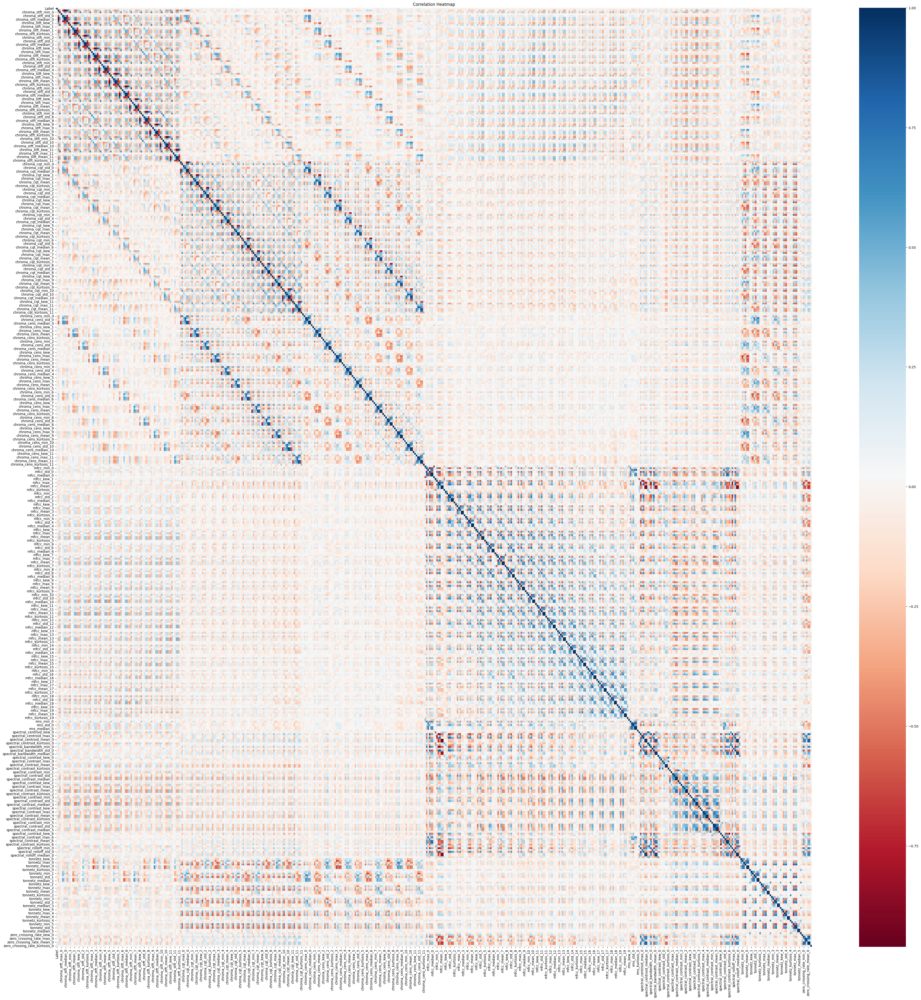

In [181]:
#EDA - Bivaraite
# Heatmap: Correlation
#See the correlation between variables
plt.figure(figsize=(50,50))
sns.heatmap(data.corr(),cbar=True,cmap = 'RdBu')
plt.title("Correlation Heatmap")

In [182]:
#Looking into the relationship between these features since there is kind of pattern in the number of null values

data.corr().style.background_gradient(cmap='coolwarm')


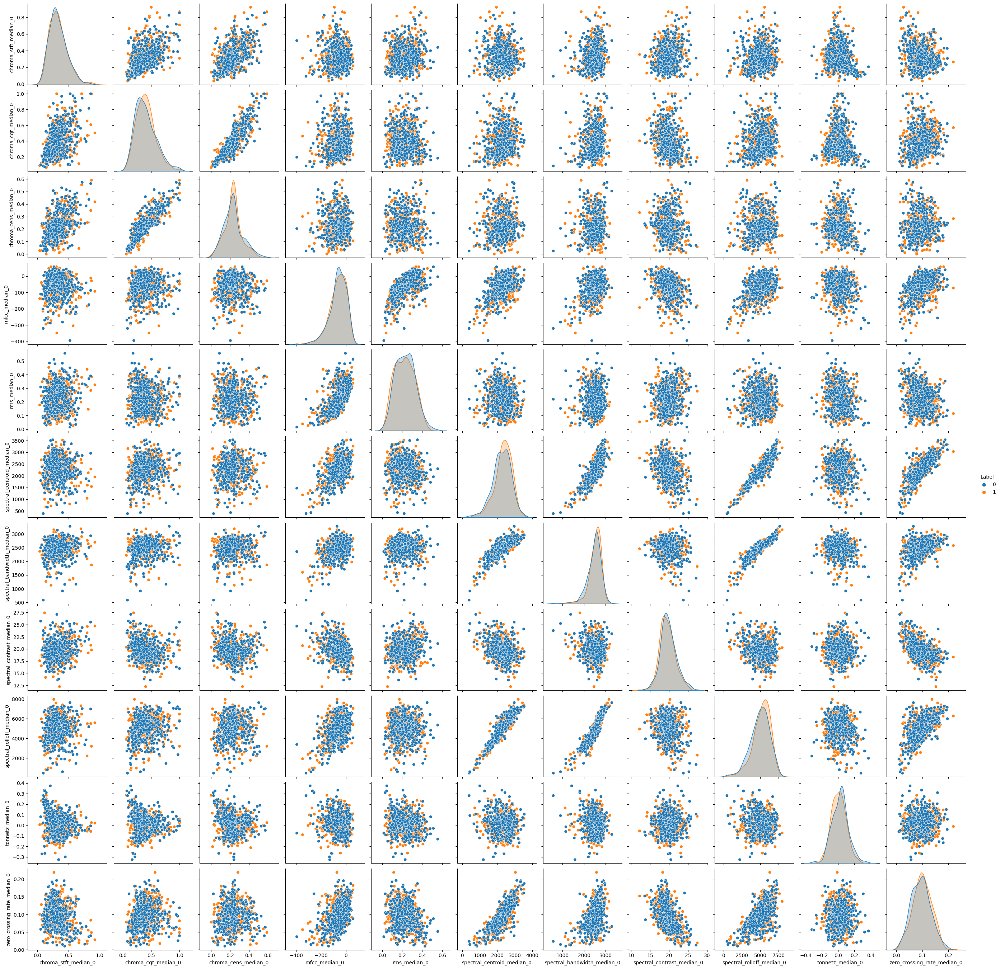

In [183]:
# Data exploration and dimension reduction

## Figure 1. Pair Scatter Plot shows the pair plot of the median values of all major audio features.
columns = data.columns
median_columns = ['Label']
for column in columns:
    if column .count('median_0') > 0:
        median_columns.append(column)

sns.pairplot(data[median_columns], hue='Label')

[pca] >Processing dataframe..
[pca] >Normalizing input data per feature (zero mean and unit variance)..
[pca] >The PCA reduction is performed to capture [95.0%] explained variance using the [519] columns of the input data.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Compute explained variance.
[pca] >Number of components is [170] that covers the [95.00%] explained variance.
[pca] >The PCA reduction is performed on the [519] columns of the input dataframe.
[pca] >Fit using PCA.
[pca] >Compute loadings and PCs.
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[170]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


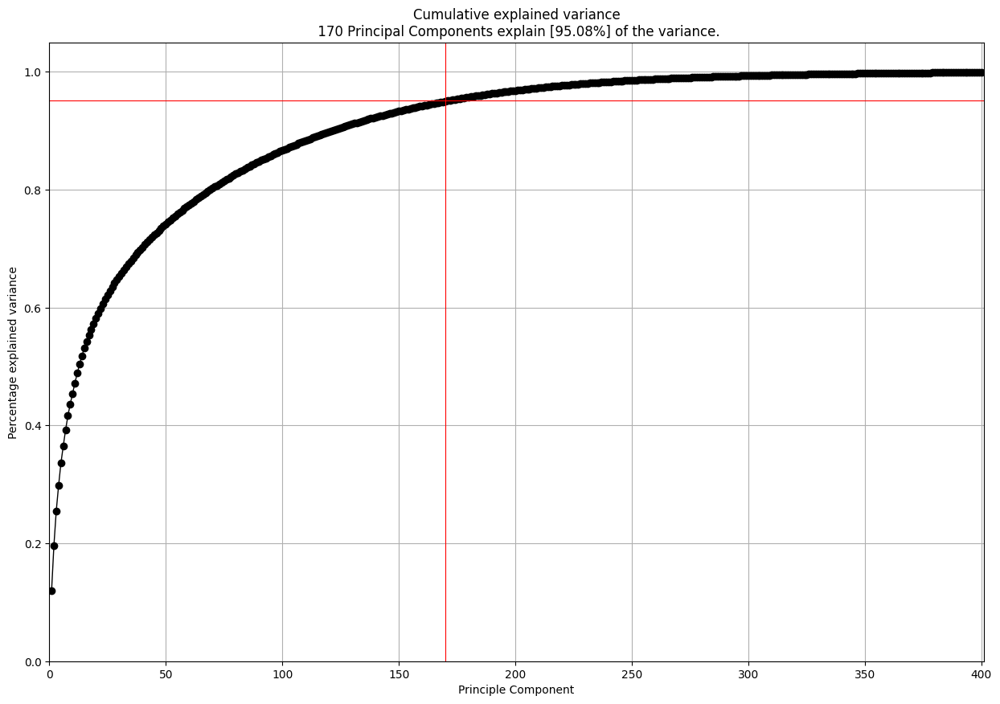

[pca] >Plot PC1 vs PC2 with loadings.


<Figure size 640x480 with 0 Axes>

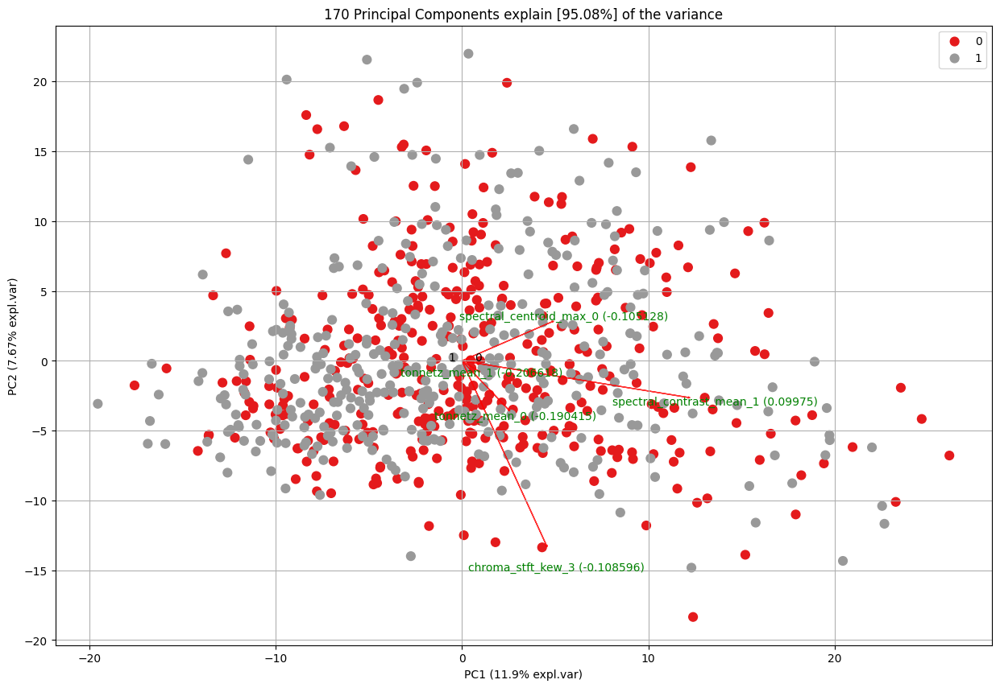

In [184]:
from pca import pca

X = data.drop('Artist', axis=1).drop('Title',axis=1).drop('title',axis=1)

# Initialize to reduce the data up to the nubmer of components that explains 95% of the variance.
model = pca(normalize=True)

# Fit transform
out = model.fit_transform(X)

## Figure 2 shows the cumulative explained variance of PCA.
# Plot explained variance
fig, ax = model.plot(n_components=400)

# Figure 3 shows the biplot of the top two PCs. Similar to the previous pair plot, there is no clear clustering within the first two PCs.
# Make biplot with the number of features
fig, ax = model.biplot(y=data['Label'], n_feat=5)

df = pd.DataFrame(out['topfeat'])
df[df['type']=='best']

columns = list(df['feature'][df['type']=='best'])

### Get the data X,y; we'll use these data for model building

In [185]:
X = data[columns]
y = data['Label'] #target variable

### But before building a model, I want to check if the data have imbalanced problem

0    373
1    369
Name: Label, dtype: int64


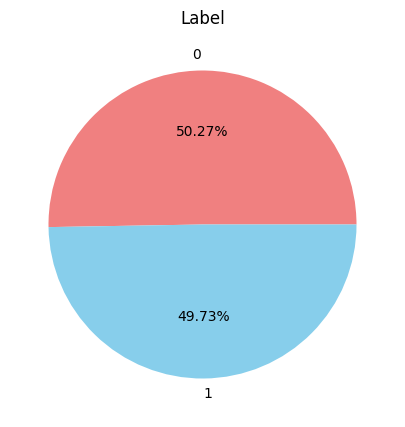

In [186]:
#But before building a model, I want to check if the data have an imbalanced problem
import matplotlib.pyplot as plt

print(y.value_counts())

plt.figure( figsize=(10,5) )
y.value_counts().plot( kind='pie', colors=['lightcoral','skyblue'], autopct='%1.2f%%' )
plt.title( 'Label' )  # 圖標題
plt.ylabel( '' )
plt.show()

In [187]:
# feature columns
x = new_df.iloc[:,5:]

# target column
y = new_df['Label']


In [188]:
# Balance imbalanced dataset
from imblearn.over_sampling import RandomOverSampler
from imblearn.combine import SMOTETomek

#os =  RandomOverSampler(sampling_strategy=1)
os =  SMOTETomek(sampling_strategy=1)

X_res, y_res = os.fit_resample(x, y)
X_res.shape,y_res.shape

((54, 517), (54,))

In [189]:
#split it into train and test dataset
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_res,y_res,test_size=0.2,random_state=0)

print(" Training data: ",X_train.shape)
print(" Testing data:  ",X_test.shape)

 Training data:  (43, 517)
 Testing data:   (11, 517)


In [190]:
# # feature columns
# x = new_df.iloc[:,5:]

# # target column
# y = new_df['Label']


In [191]:
# # Balance imbalanced dataset
# from imblearn.over_sampling import RandomOverSampler
# from imblearn.combine import SMOTETomek

# #os =  RandomOverSampler(sampling_strategy=1)
# os =  SMOTETomek(sampling_strategy=1)

# X_res, y_res = os.fit_resample(x, y)
# X_res.shape,y_res.shape

In [192]:
from collections import Counter
print('Original dataset shape {}'.format(Counter(y)))
print('Resampled dataset shape {}'.format(Counter(y_res)))

Original dataset shape Counter({1: 31, 0: 13})
Resampled dataset shape Counter({1: 27, 0: 27})


In [193]:
from sklearn.feature_selection import mutual_info_classif
# determine the mutual information
mutual_info = mutual_info_classif(X_train, y_train)
mutual_info


array([0.00000000e+00, 7.74384997e-02, 0.00000000e+00, 7.18359627e-02,
       9.84970923e-02, 1.29036160e-02, 9.58136000e-02, 0.00000000e+00,
       0.00000000e+00, 1.21023597e-01, 1.27443437e-01, 8.46445048e-03,
       1.46295086e-01, 8.05781577e-03, 5.93523868e-02, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 2.00308239e-03, 0.00000000e+00,
       5.49192876e-02, 1.51568504e-01, 0.00000000e+00, 2.65103581e-02,
       6.62619501e-02, 0.00000000e+00, 0.00000000e+00, 3.01852362e-02,
       4.89473526e-02, 0.00000000e+00, 0.00000000e+00, 2.16329357e-02,
       6.90774809e-02, 5.40601984e-02, 1.46262733e-01, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 9.31915451e-02, 2.01211110e-01,
       9.02301141e-02, 9.57715043e-02, 2.81105021e-02, 1.57079595e-01,
       1.13051272e-01, 0.00000000e+00, 0.00000000e+00, 9.16101162e-02,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       4.72056834e-02, 0.00000000e+00, 8.00791957e-02, 2.21903634e-01,
      

In [194]:
# Sorting feature importance from highest to lowest
mutual_info = pd.Series(mutual_info)
mutual_info.index = X_train.columns
mutual_info.sort_values(ascending=False)

mfcc_kurtosis_5            0.425637
spectral_contrast_min_4    0.398435
chroma_stft_kurtosis_8     0.378044
mfcc_std_6                 0.361193
spectral_contrast_std_3    0.359919
                             ...   
chroma_cens_max_10         0.000000
chroma_cens_std_10         0.000000
chroma_cens_min_11         0.000000
chroma_cens_max_11         0.000000
mfcc_kew_1                 0.000000
Length: 517, dtype: float64

In [195]:
from sklearn.feature_selection import SelectKBest
# Selecting the top 25 important features
sel_five_cols = SelectKBest(mutual_info_classif, k=25)
sel_five_cols.fit(X_train, y_train)
best=X_train.columns[sel_five_cols.get_support()]
print(best)

Index(['chroma_stft_kew_8', 'chroma_stft_median_8', 'chroma_stft_kurtosis_8',
       'chroma_stft_mean_11', 'chroma_stft_median_11', 'chroma_cens_median_7',
       'mfcc_kurtosis_5', 'mfcc_std_6', 'mfcc_mean_7', 'mfcc_kew_8',
       'mfcc_median_8', 'mfcc_max_11', 'mfcc_std_12', 'mfcc_std_14',
       'mfcc_mean_14', 'mfcc_median_14', 'mfcc_kew_15', 'mfcc_median_16',
       'rms_std_0', 'spectral_contrast_std_3', 'spectral_contrast_min_4',
       'spectral_contrast_median_6', 'tonnetz_kew_2', 'tonnetz_mean_2',
       'tonnetz_median_2'],
      dtype='object')


In [196]:
# List of features
be = list(best)
print(len(be))

25


In [197]:
x_train = X_train[be]
x_test = X_test[be]

In [198]:
# Normalization
from sklearn.preprocessing import MinMaxScaler

# fit scaler on training data
norm = MinMaxScaler().fit(x_train)

# transform training data
x1_train = norm.transform(x_train)

# transform testing dataabs
x1_test = norm.transform(x_test)


## Model Building 
* Logistic regression
* Random forrest classification 
* Support vector machine
* Decision Tree

## Logistic Regression

In [199]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV


In [200]:
# GridSearchCV For Hyperparameter Tuning
log = LogisticRegression()
grid={'C': 10.0**np.arange(-3,3), 'penalty':['l1','l2']}
cv= KFold(n_splits = 5, random_state=None, shuffle=False)


In [201]:
clf = GridSearchCV(log, grid, cv=cv, n_jobs=-1, scoring='f1_macro')
clf.fit(x1_train,y_train)

GridSearchCV(cv=KFold(n_splits=5, random_state=None, shuffle=False),
             estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': array([1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02]),
                         'penalty': ['l1', 'l2']},
             scoring='f1_macro')

In [202]:
y_pred=clf.predict(x1_test)
print(confusion_matrix(y_test,y_pred))
print(accuracy_score(y_test,y_pred))
print(classification_report(y_test,y_pred))


[[4 3]
 [1 3]]
0.6363636363636364
              precision    recall  f1-score   support

           0       0.80      0.57      0.67         7
           1       0.50      0.75      0.60         4

    accuracy                           0.64        11
   macro avg       0.65      0.66      0.63        11
weighted avg       0.69      0.64      0.64        11



In [203]:
clf.score(x1_train,y_train)

0.9069264069264069

In [204]:
clf.score(x1_test,y_test)

0.6333333333333333

In [205]:
# Saving model to disk
pickle.dump(clf, open('lrmodel.pkl','wb'))


### Random forrest classification

In [206]:
#Build Model
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score

 
randomForestModel = RandomForestClassifier(n_estimators=500, criterion = 'gini',max_depth = 10, max_leaf_nodes=16,random_state=100)
#randomForestModel = RandomForestClassifier(n_estimators=500, max_leaf_nodes=16, n_jobs=-1)

accuracies = cross_val_score(randomForestModel, x1_train, y_train, cv=5)
randomForestModel.fit(x1_train, y_train)

#result - Train dataset
print(accuracies)
print('Train dataset Accuracy(cross_val_score): ',np.mean(accuracies))
print('Train dataset Accuracy: ',randomForestModel.score(x1_train,y_train))

[1.         0.88888889 1.         1.         0.875     ]
Train dataset Accuracy(cross_val_score):  0.9527777777777778
Train dataset Accuracy:  1.0


In [207]:
#result - Test dataset

#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics
y_pred=randomForestModel.predict(x1_test)

test_accuracies = cross_val_score(randomForestModel, x1_test, y_test, cv=5)

In [208]:
print(confusion_matrix(y_test, randomForestModel.predict(x1_test)))

[[6 1]
 [0 4]]


In [209]:
print(test_accuracies)
print('Test dataset Accuracy(cross_val_score): ',np.mean(test_accuracies))
print("Test dataset Accuracy:",metrics.accuracy_score(y_test, y_pred))
 

[0.66666667 0.5        0.5        0.5        1.        ]
Test dataset Accuracy(cross_val_score):  0.6333333333333333
Test dataset Accuracy: 0.9090909090909091


In [215]:
#result-3
from sklearn.metrics import classification_report
pred=randomForestModel.predict(x1_test)
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       1.00      0.86      0.92         7
           1       0.80      1.00      0.89         4

    accuracy                           0.91        11
   macro avg       0.90      0.93      0.91        11
weighted avg       0.93      0.91      0.91        11



In [216]:
randomForestModel.score(x1_train,y_train)

1.0

In [217]:
randomForestModel.score(x1_test,y_test)

0.9090909090909091

In [218]:
# Saving model to disk
pickle.dump(randomForestModel, open('rfmodel.pkl','wb'))


### Support vector machine

In [219]:
from sklearn.svm import SVC
svm = SVC(kernel='linear', probability=True)
svm.fit(x1_train,y_train)

SVC(kernel='linear', probability=True)

In [220]:
print(confusion_matrix(y_test, svm.predict(x1_test)))

[[6 1]
 [0 4]]


In [221]:
print(svm.score(x1_train,y_train))
print(svm.score(x1_test, y_test))

0.9302325581395349
0.9090909090909091


In [222]:
#result-3
from sklearn.metrics import classification_report
pred=svm.predict(x1_test)
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       1.00      0.86      0.92         7
           1       0.80      1.00      0.89         4

    accuracy                           0.91        11
   macro avg       0.90      0.93      0.91        11
weighted avg       0.93      0.91      0.91        11



In [223]:
# Saving model to disk
pickle.dump(svm, open('svmmodel.pkl','wb'))

### Decision Tree

In [224]:
from sklearn.tree import DecisionTreeClassifier 
  
# create a regressor object
DecisionTree  = DecisionTreeClassifier(random_state = 0) 
  
# fit the regressor with X and Y data
DecisionTree.fit(x1_train , y_train )

DecisionTreeClassifier(random_state=0)

In [225]:
test_accuracies = cross_val_score(DecisionTree, x1_test, y_test, cv=5)
print('Test dataset Accuracy(cross_val_score): ',np.mean(test_accuracies))
print('Test dataset Accuracy: ',DecisionTree.score(x1_test,y_test))

Test dataset Accuracy(cross_val_score):  0.6
Test dataset Accuracy:  0.8181818181818182


In [226]:
from sklearn.metrics import classification_report
DTpred=DecisionTree.predict(x1_test)
print(classification_report(y_test,DTpred))

              precision    recall  f1-score   support

           0       0.86      0.86      0.86         7
           1       0.75      0.75      0.75         4

    accuracy                           0.82        11
   macro avg       0.80      0.80      0.80        11
weighted avg       0.82      0.82      0.82        11



In [227]:
# Saving model to disk
pickle.dump(DecisionTree, open('dtmodel.pkl','wb'))